# Global Sensitivity Analysis of *PFSS $\to$ WSA $\to$ HUX* for CR2053

In [22]:
import numpy as np 
import matplotlib.pyplot as plt
import os
from model_chain import run_chain_of_models, get_ace_date
from SA_tools.sobol import estimate_sobol
import datetime as dt
from sunpy.coordinates.sun import carrington_rotation_time
import matplotlib
font = {'family' : 'serif',
        'size'   : 15}

matplotlib.rc('font', **font)
matplotlib.rc('xtick', labelsize=14) 
matplotlib.rc('ytick', labelsize=14) 

# Get ACE data

In [23]:
# set up carrington rotation
CR = "2053"
start_time = dt.datetime(year=2007, month=2, day=4, hour=20, minute=4, second=57)
end_time = dt.datetime(year=2007, month=3, day=4, hour=4, minute=9, second=43)

# get ace data
ACE_longitude, ACE_latitude, ACE_r, ACE_vr, ACE_obstime = get_ace_date(start_time=start_time, end_time=end_time)

# Directory with Results

In [24]:
# directory with results
dir_name_A = os.getcwd() + "/SA_results/CR" + str(CR) + "/A"
dir_name_T = os.getcwd() + "/SA_results/CR" + str(CR) + "/Total"

N_curr=1000

In [25]:
YA = np.zeros((len(ACE_longitude), N_curr))
YB = np.zeros((len(ACE_longitude), N_curr))

In [26]:
for ii in range(N_curr):
    YA[:, ii] = np.load(dir_name_A + "/simulation_output/A" + str(ii) + "/vr_hux_sample_A" + str(ii) + ".npy")
    YB[:, ii] = np.load(dir_name_A + "/simulation_output/B" + str(ii) + "/vr_hux_sample_B" + str(ii) + ".npy")

# Ensemble Runs

In [27]:
std_A = np.std(YA, axis=1)
std_B = np.std(YB, axis=1)
mean_A = np.mean(YA, axis=1)
mean_B = np.mean(YB, axis=1)

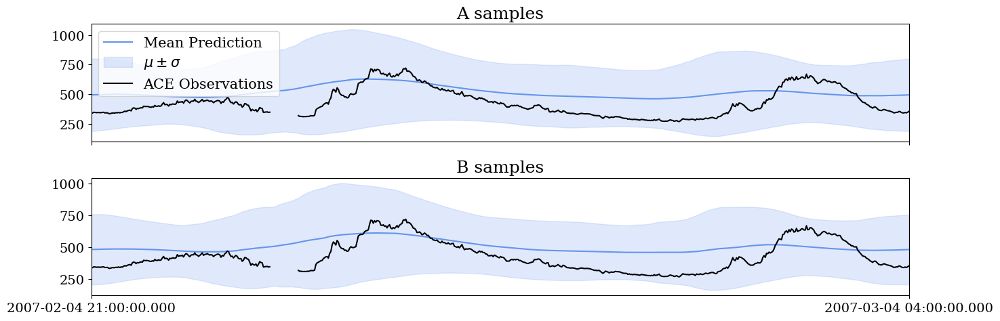

In [28]:
fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(15, 5))
ax[0].plot(ACE_obstime.value, mean_A, c="cornflowerblue", label="Mean Prediction")
ax[1].plot(ACE_obstime.value, mean_B, c="cornflowerblue", label="Mean Prediction")
ax[0].fill_between(ACE_obstime.value, (mean_A-std_A), (mean_A+std_A), 
                   color='cornflowerblue', alpha=.2, label=r"$ \mu \pm \sigma$")
ax[0].plot(ACE_obstime.value, ACE_vr, c="black", label="ACE Observations")
ax[1].fill_between(ACE_obstime.value, (mean_B-std_B), (mean_B+std_B), 
                   color='cornflowerblue', alpha=.2, label=r"$ \mu \pm \sigma$")
ax[1].plot(ACE_obstime.value, ACE_vr, c="black", label="ACE Observations")
ax[0].legend()

ax[0].set_xlim(ACE_obstime[0].value, ACE_obstime[-1].value)
ax[1].set_xlim(ACE_obstime[0].value, ACE_obstime[-1].value)
ax[0].set_xticks(np.linspace(min(ACE_obstime), max(ACE_obstime), 2).value)
ax[0].set_title("A samples")
ax[1].set_title("B samples")
plt.tight_layout()

# Sobol' Sensitivity Indicies

The main effect is 
$$
S_{i} = \frac{\frac{1}{N} y_{A}^{\top}y_{C^{(i)}} - f_{0}^2}{\frac{1}{N} y_{A}^{\top} y_{A} - f_{0}^2}
$$
and the total effect is 
$$
T_{i} = 1 - \frac{\frac{1}{N} y_{B}^{\top}y_{C^{(i)}} - f_{0}^2}{\frac{1}{N} y_{A}^{\top} y_{A} - f_{0}^2}
$$
with 
$f_{0} = \mathbb{E}[Y] \approx \frac{1}{N} \sum_{j=1}^{N} y_{A}^{(j)}$. Variants on the Sobol’ estimator exist, including the Saltelli estimator, Owen estimator, and Janon estimator. 

In [44]:
N_curr = 3100
type_estimator="sobol" # options are: "owen", "janon", "saltelli_II", "saltelli_I", "sobol"

In [45]:
# estimate sobol indices (MAE)
# A folder
YA_MAE = np.load(dir_name_T + "/simulation_MAE/YA.npy")[:N_curr]
YB_MAE = np.load(dir_name_T + "/simulation_MAE/YB.npy")[:N_curr]
YC_MAE = np.load(dir_name_T + "/simulation_MAE/YC.npy")[:N_curr, :]

main_effect_MAE, total_effect_MAE = estimate_sobol(YA_MAE, YB_MAE, YC_MAE, type_estimator)

In [46]:
# estimate sobol indices (RMSE)
YA_RMSE = np.load(dir_name_T + "/simulation_RMSE/YA.npy")[:N_curr]
YB_RMSE = np.load(dir_name_T + "/simulation_RMSE/YB.npy")[:N_curr]
YC_RMSE = np.load(dir_name_T + "/simulation_RMSE/YC.npy")[:N_curr, :]
main_effect_RMSE, total_effect_RMSE = estimate_sobol(YA_RMSE, YB_RMSE, YC_RMSE,  type_estimator)

In [47]:
# estimate sobol indices (PCC)
YA_PCC = np.load(dir_name_T + "/simulation_PCC/YA.npy")[:N_curr]
YB_PCC = np.load(dir_name_T + "/simulation_PCC/YB.npy")[:N_curr]
YC_PCC = np.load(dir_name_T + "/simulation_PCC/YC.npy")[:N_curr, :]
main_effect_PCC, total_effect_PCC = estimate_sobol(YA_PCC, YB_PCC, YC_PCC,  type_estimator)

Text(0.5, 0, 'Sample Index')

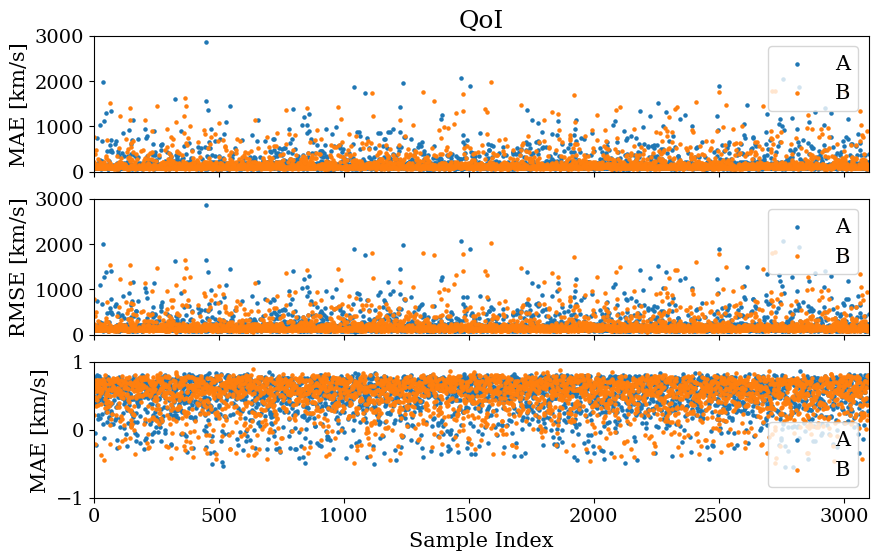

In [48]:
fig, ax = plt.subplots(nrows=3, sharex=True, figsize=(10, 6))
ax[0].scatter(np.arange(N_curr), YA_MAE,  s=5, label="A")
ax[0].scatter(np.arange(N_curr), YB_MAE, s=5, label="B")
ax[0].set_ylabel("MAE [km/s]")
ax[0].set_xlim(0, N_curr)
ax[0].set_ylim(0, 3000)
ax[0].legend()


ax[1].scatter(np.arange(N_curr), YA_RMSE,  s=5, label="A")
ax[1].scatter(np.arange(N_curr), YB_RMSE, s=5, label="B")
ax[1].set_ylabel("RMSE [km/s]")
ax[1].set_xlim(0, N_curr)
ax[1].set_ylim(0, 3000)
ax[1].legend()

ax[2].scatter(np.arange(N_curr), YA_PCC,  s=5, label="A")
ax[2].scatter(np.arange(N_curr), YB_PCC, s=5, label="B")
ax[2].set_ylabel("MAE [km/s]")
ax[2].set_xlim(0, N_curr)
ax[2].set_ylim(-1, 1)
ax[2].legend()

ax[0].set_title("QoI")
ax[2].set_xlabel("Sample Index")

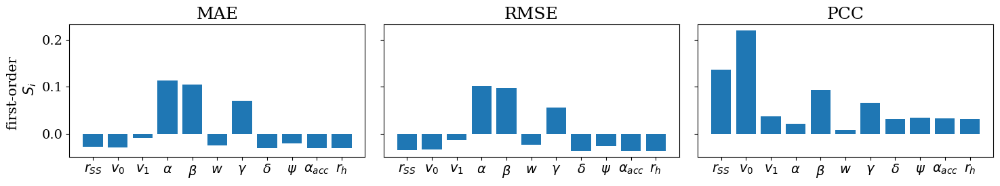

In [49]:
fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True, figsize=(15, 3))

d = 11 # number of parameters

_ = ax[0].bar(np.arange(d), main_effect_MAE)
_ = ax[0].set_xticks(np.arange(d))
_ = ax[0].set_title("MAE")


_ = ax[1].bar(np.arange(d), main_effect_RMSE)
_ = ax[1].set_xticks(np.arange(d))
_ = ax[1].set_title("RMSE")


_ = ax[2].bar(np.arange(d), main_effect_PCC)
_ = ax[2].set_xticks(np.arange(d))
_ = ax[2].set_title("PCC")

_ = ax[0].set_xticklabels([r"$r_{SS}$", r"$v_{0}$", r"$v_{1}$", r"$\alpha$", r"$\beta$", r"$w$", r"$\gamma$", r"$\delta$", r"$\psi$", r"$ \alpha_{acc}$", r"$r_{h}$"])
#_ = ax[0].set_ylim(bottom=0)
_ = ax[0].set_ylabel("first-order \n $S_{i}$")
plt.tight_layout()

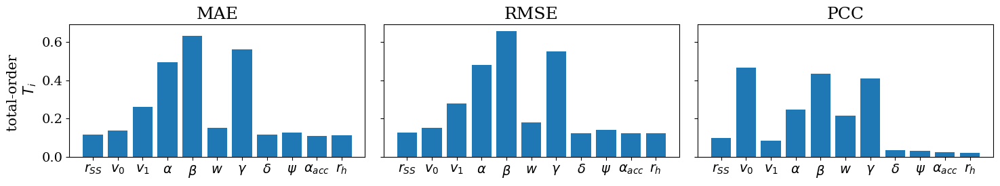

In [50]:
fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True, figsize=(15, 3))

d = 11
_ = ax[0].bar(np.arange(d), total_effect_MAE)
_ = ax[0].set_xticks(np.arange(d))
_ = ax[0].set_title("MAE")


_ = ax[1].bar(np.arange(d), total_effect_RMSE)
_ = ax[1].set_xticks(np.arange(d))
_ = ax[1].set_title("RMSE")


_ = ax[2].bar(np.arange(d), total_effect_PCC)
_ = ax[2].set_xticks(np.arange(d))
_ = ax[2].set_title("PCC")

_ = ax[0].set_xticklabels([r"$r_{SS}$", r"$v_{0}$", r"$v_{1}$", r"$\alpha$", r"$\beta$", r"$w$", r"$\gamma$", r"$\delta$", r"$\psi$", r"$ \alpha_{acc}$", r"$r_{h}$"])
#_ = ax[0].set_ylim(bottom=0)
_ = ax[0].set_ylabel("total-order \n $T_{i}$")
plt.tight_layout()

# Test Convergence  "Law of Large Numbers"

In [51]:
test_points = np.arange(100, N_curr)
main_results = np.zeros((d, len(test_points), 3))
total_results = np.zeros((d, len(test_points), 3))

jj=0
for ii in test_points: 
    main_results[:, jj, 0], total_results[:, jj, 0] = estimate_sobol(YA_MAE[:ii], YB_MAE[:ii], YC_MAE[:ii, :], type_estimator)
    main_results[:, jj, 1], total_results[:, jj, 1] = estimate_sobol(YA_RMSE[:ii], YB_RMSE[:ii], YC_RMSE[:ii, :], type_estimator)
    main_results[:, jj, 2], total_results[:, jj, 2] = estimate_sobol(YA_PCC[:ii], YB_PCC[:ii], YC_PCC[:ii, :], type_estimator)
    jj+=1

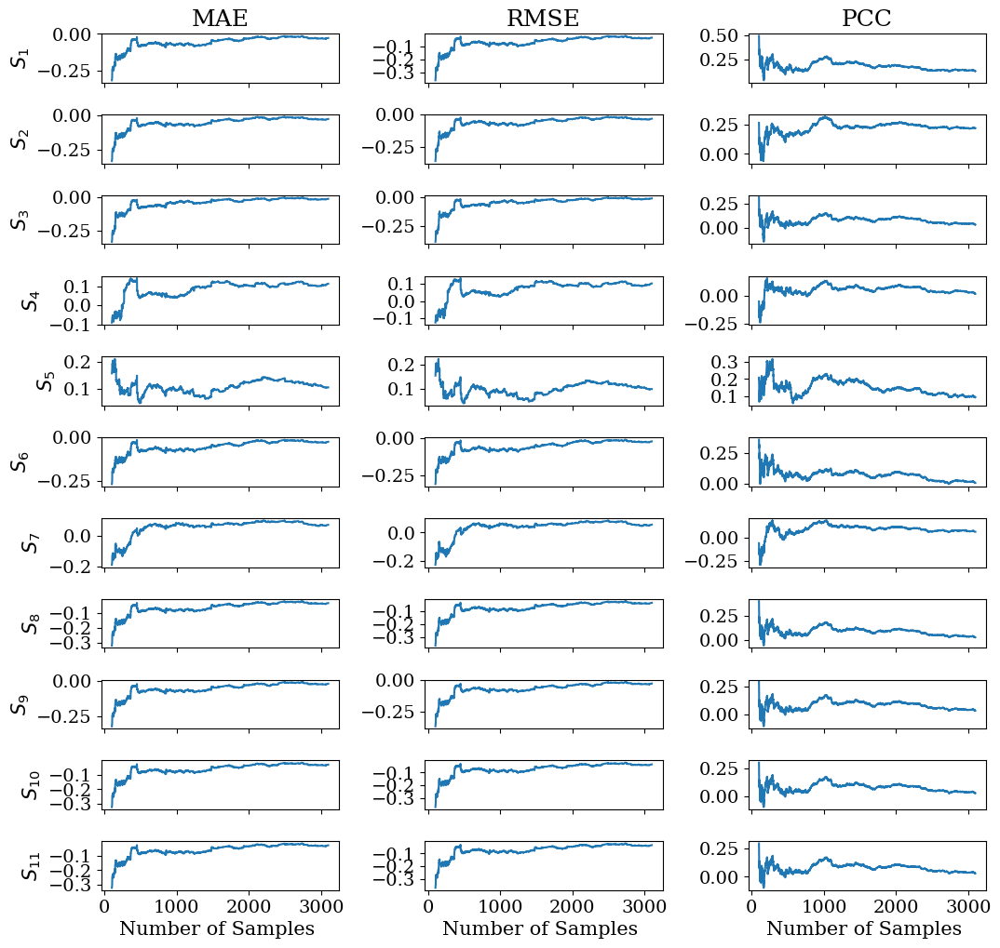

In [52]:
fig, ax = plt.subplots(ncols=3, nrows=11, sharex=True, figsize=(11, 10))

for ii in range(d):
    ax[ii, 0].plot(test_points, main_results[ii, :, 0])
    ax[ii, 1].plot(test_points, main_results[ii, :, 1])
    ax[ii, 2].plot(test_points, main_results[ii, :, 2])
    ax[ii, 0].set_ylabel("$S_{"+ str(ii+1) + "}$")
    
plt.tight_layout()
_ = ax[-1, 0].set_xlabel("Number of Samples ")
_ = ax[-1, 1].set_xlabel("Number of Samples ")
_ = ax[-1, 2].set_xlabel("Number of Samples ")

_ = ax[0, 0].set_title("MAE")
_ = ax[0, 1].set_title("RMSE")
_ = ax[0, 2].set_title("PCC")

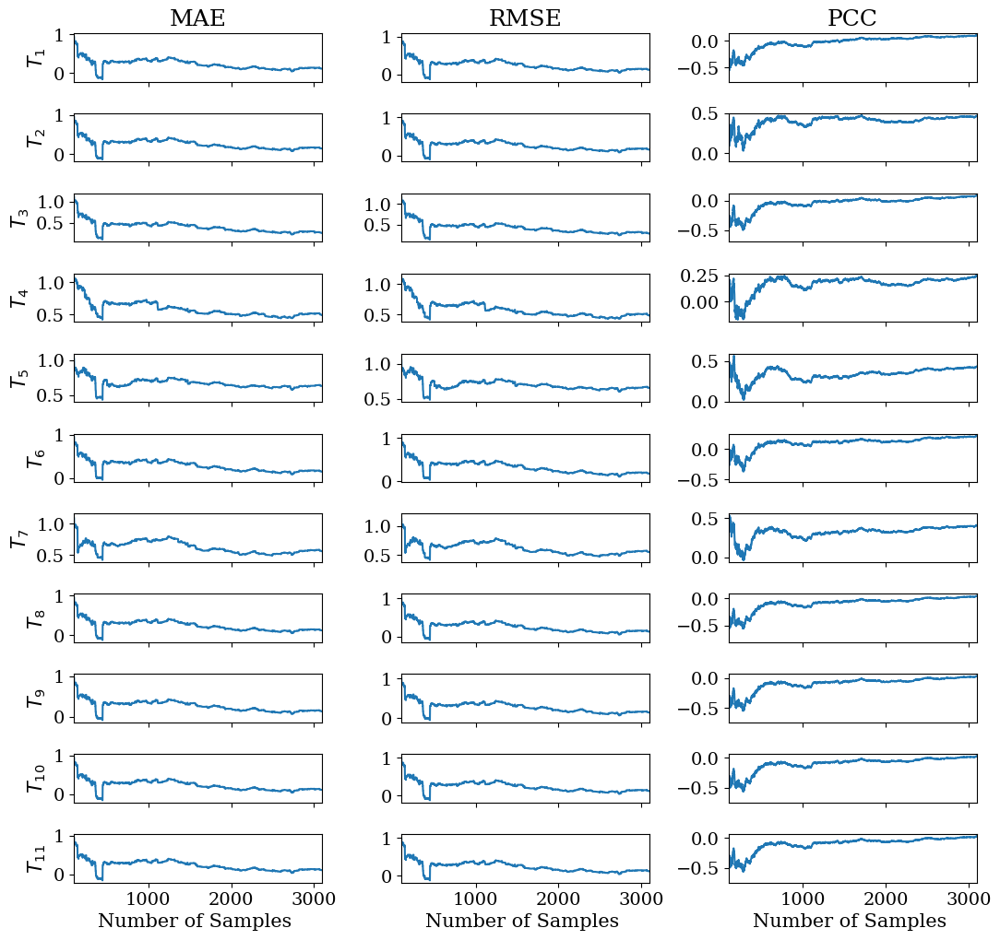

In [53]:
fig, ax = plt.subplots(ncols=3, nrows=11, sharex=True, figsize=(11, 10))

for ii in range(d):
    ax[ii, 0].plot(test_points, total_results[ii, :, 0])
    ax[ii, 1].plot(test_points, total_results[ii, :, 1])
    ax[ii, 2].plot(test_points, total_results[ii, :, 2])
    ax[ii, 0].set_ylabel("$T_{"+ str(ii+1) + "}$")
    
plt.tight_layout()
_ = ax[-1, 0].set_xlabel("Number of Samples ")
_ = ax[-1, 1].set_xlabel("Number of Samples ")
_ = ax[-1, 2].set_xlabel("Number of Samples ")
_ = ax[0, 0].set_xlim(100, N_curr)
#_ = ax[0, 0].set_xticks(np.arange(0, N_curr, 400))
_ = ax[0, 0].set_title("MAE")
_ = ax[0, 1].set_title("RMSE")
_ = ax[0, 2].set_title("PCC")

# Results in Parameter Space

In [40]:
# get samples
A = np.load("SA_results/CR" + str(CR) + "/Total/samples/A_sample_total.npy")[:N_curr, :]
B = np.load("SA_results/CR" + str(CR) + "/Total/samples/B_sample_total.npy")[:N_curr, :]

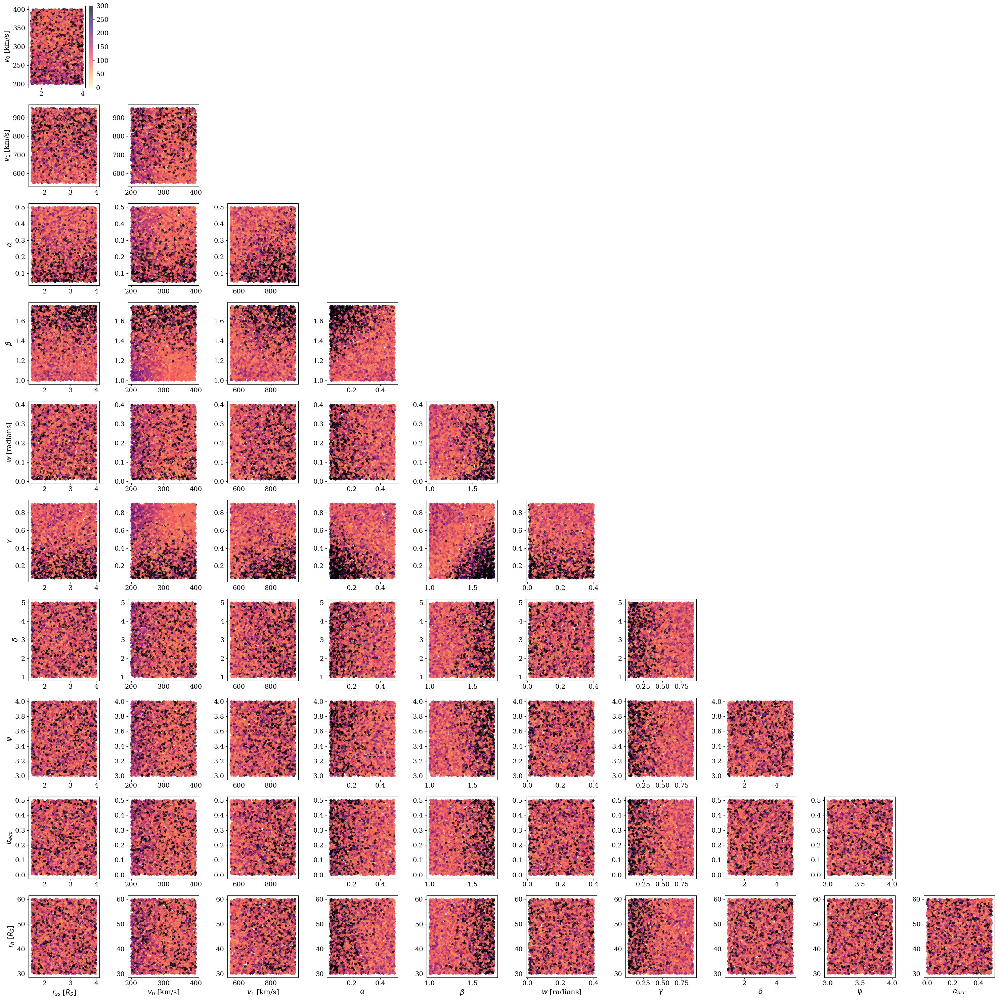

In [41]:
fig, ax = plt.subplots(ncols=d-1, nrows=d-1, figsize=(30, 30))

norm = plt.Normalize(0, 300)

for jj in range(d-1):
    for ii in range(d-1):
        if jj <= ii:
            x = np.append(A[:, jj], B[:, jj])
            y = np.append(A[:, ii+1], B[:, ii+1])
            color = np.append(np.abs(YA_MAE), np.abs(YB_MAE))
            pos = ax[ii, jj].scatter(x, y, c=color, cmap='magma_r', s=17, alpha=0.7, norm=norm)
            if ii ==0 and jj==0:
                fig.colorbar(pos, ax=ax[ii, jj])
        else:
            ax[ii, jj].set_xticks([])
            ax[ii, jj].set_yticks([])
            ax[ii, jj].spines['top'].set_visible(False)
            ax[ii, jj].spines['right'].set_visible(False)
            ax[ii, jj].spines['bottom'].set_visible(False)
            ax[ii, jj].spines['left'].set_visible(False)


ax[-1, 0].set_xlabel(r"$r_{ss}$ [$R_{S}$]")
ax[-1, 1].set_xlabel(r"$v_{0}$ [km/s]")
ax[-1, 2].set_xlabel(r"$v_{1}$ [km/s]")
ax[-1, 3].set_xlabel(r"$\alpha$")
ax[-1, 4].set_xlabel(r"$\beta$")
ax[-1, 5].set_xlabel(r"$w$ [radians]")
ax[-1, 6].set_xlabel(r"$\gamma$")
ax[-1, 7].set_xlabel(r"$\delta$")
ax[-1, 8].set_xlabel(r"$\psi$")
ax[-1, 9].set_xlabel(r"$\alpha_{acc}$")

ax[9, 0].set_ylabel(r"$r_{h}$ $[R_{S}]$")
ax[0, 0].set_ylabel(r"$v_{0}$ [km/s]")
ax[1, 0].set_ylabel(r"$v_{1}$ [km/s]")
ax[2, 0].set_ylabel(r"$\alpha$")
ax[3, 0].set_ylabel(r"$\beta$")
ax[4, 0].set_ylabel(r"$w$ [radians]")
ax[5, 0].set_ylabel(r"$\gamma$")
ax[6, 0].set_ylabel(r"$\delta$")
ax[7, 0].set_ylabel(r"$\psi$")
ax[8, 0].set_ylabel(r"$\alpha_{acc}$")

plt.tight_layout()
plt.savefig("figs/CR" + str(CR) + "/MAE_parameter_space.png", dpi=500)

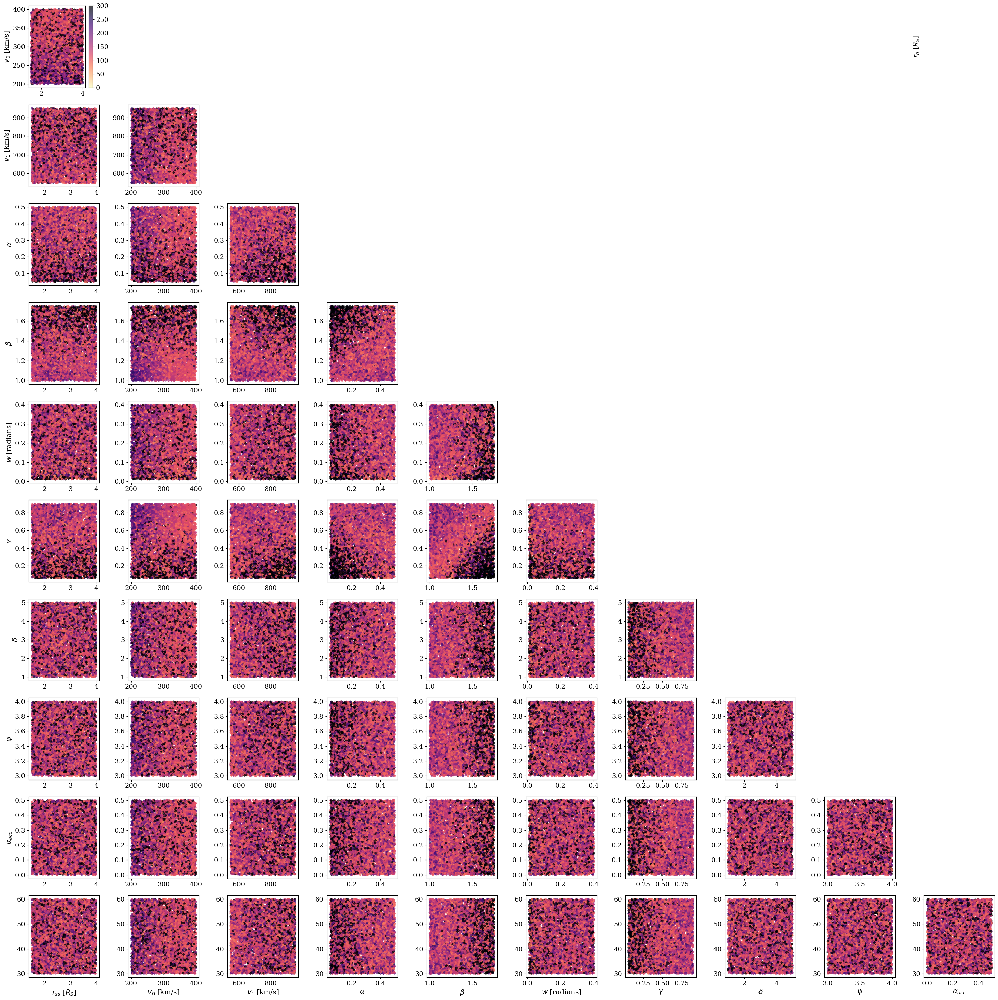

In [42]:
fig, ax = plt.subplots(ncols=d-1, nrows=d-1, figsize=(30, 30))

norm = plt.Normalize(0, 300)

for jj in range(d-1):
    for ii in range(d-1):
        if jj <= ii:
            x = np.append(A[:, jj], B[:, jj])
            y = np.append(A[:, ii+1], B[:, ii+1])
            color = np.append(YA_RMSE, YB_RMSE)
            pos = ax[ii, jj].scatter(x, y, c=color, cmap='magma_r', s=17, alpha=0.7, norm=norm)
            if jj==0 and ii==0:
                fig.colorbar(pos, ax=ax[ii, jj])
        else:
            ax[ii, jj].set_xticks([])
            ax[ii, jj].set_yticks([])
            ax[ii, jj].spines['top'].set_visible(False)
            ax[ii, jj].spines['right'].set_visible(False)
            ax[ii, jj].spines['bottom'].set_visible(False)
            ax[ii, jj].spines['left'].set_visible(False)


ax[-1, 0].set_xlabel(r"$r_{ss}$ [$R_{S}$]")
ax[-1, 1].set_xlabel(r"$v_{0}$ [km/s]")
ax[-1, 2].set_xlabel(r"$v_{1}$ [km/s]")
ax[-1, 3].set_xlabel(r"$\alpha$")
ax[-1, 4].set_xlabel(r"$\beta$")
ax[-1, 5].set_xlabel(r"$w$ [radians]")
ax[-1, 6].set_xlabel(r"$\gamma$")
ax[-1, 7].set_xlabel(r"$\delta$")
ax[-1, 8].set_xlabel(r"$\psi$")
ax[-1, 9].set_xlabel(r"$\alpha_{acc}$")

ax[0, 9].set_ylabel(r"$r_{h}$ $[R_{S}]$")
ax[0, 0].set_ylabel(r"$v_{0}$ [km/s]")
ax[1, 0].set_ylabel(r"$v_{1}$ [km/s]")
ax[2, 0].set_ylabel(r"$\alpha$")
ax[3, 0].set_ylabel(r"$\beta$")
ax[4, 0].set_ylabel(r"$w$ [radians]")
ax[5, 0].set_ylabel(r"$\gamma$")
ax[6, 0].set_ylabel(r"$\delta$")
ax[7, 0].set_ylabel(r"$\psi$")
ax[8, 0].set_ylabel(r"$\alpha_{acc}$")

plt.tight_layout()
plt.savefig("figs/CR" + str(CR) + "/RMSE_parameter_space.png", dpi=500)

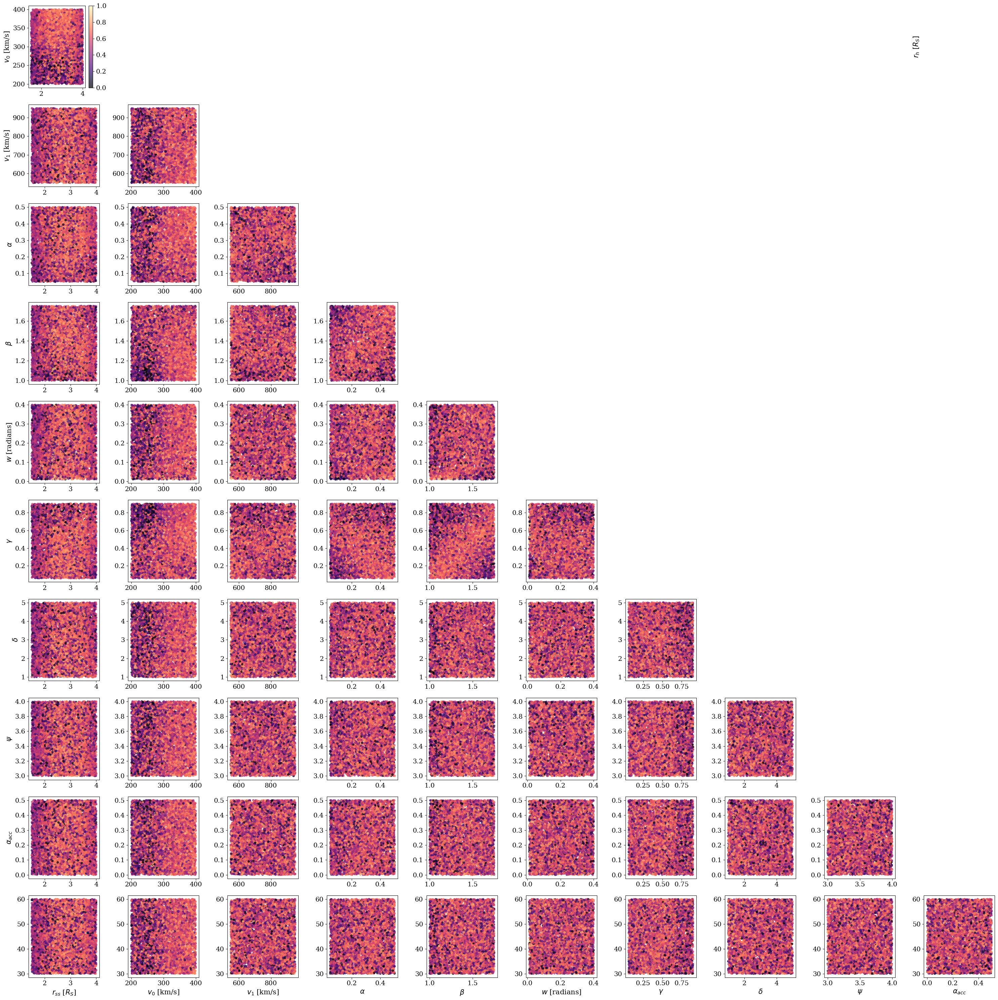

In [43]:
fig, ax = plt.subplots(ncols=d-1, nrows=d-1, figsize=(30, 30))

norm = plt.Normalize(0, 1)

for jj in range(d-1):
    for ii in range(d-1):
        if jj <= ii:
            x = np.append(A[:, jj], B[:, jj])
            y = np.append(A[:, ii+1], B[:, ii+1])
            color = np.append(np.abs(YA_PCC), np.abs(YB_PCC))
            pos = ax[ii, jj].scatter(x, y, c=color, cmap='magma', s=17, alpha=0.7, norm=norm)
            if jj==0 and ii==0:
                fig.colorbar(pos, ax=ax[ii, jj])
        else:
            ax[ii, jj].set_xticks([])
            ax[ii, jj].set_yticks([])
            ax[ii, jj].spines['top'].set_visible(False)
            ax[ii, jj].spines['right'].set_visible(False)
            ax[ii, jj].spines['bottom'].set_visible(False)
            ax[ii, jj].spines['left'].set_visible(False)


ax[-1, 0].set_xlabel(r"$r_{ss}$ [$R_{S}$]")
ax[-1, 1].set_xlabel(r"$v_{0}$ [km/s]")
ax[-1, 2].set_xlabel(r"$v_{1}$ [km/s]")
ax[-1, 3].set_xlabel(r"$\alpha$")
ax[-1, 4].set_xlabel(r"$\beta$")
ax[-1, 5].set_xlabel(r"$w$ [radians]")
ax[-1, 6].set_xlabel(r"$\gamma$")
ax[-1, 7].set_xlabel(r"$\delta$")
ax[-1, 8].set_xlabel(r"$\psi$")
ax[-1, 9].set_xlabel(r"$\alpha_{acc}$")

ax[0, 9].set_ylabel(r"$r_{h}$ $[R_{S}]$")
ax[0, 0].set_ylabel(r"$v_{0}$ [km/s]")
ax[1, 0].set_ylabel(r"$v_{1}$ [km/s]")
ax[2, 0].set_ylabel(r"$\alpha$")
ax[3, 0].set_ylabel(r"$\beta$")
ax[4, 0].set_ylabel(r"$w$ [radians]")
ax[5, 0].set_ylabel(r"$\gamma$")
ax[6, 0].set_ylabel(r"$\delta$")
ax[7, 0].set_ylabel(r"$\psi$")
ax[8, 0].set_ylabel(r"$\alpha_{acc}$")

plt.tight_layout()
plt.savefig("figs/CR" + str(CR) + "/Abs_PCC_parameter_space.png", dpi=500)